

#**INTEGRANTES**



*   Casanova, Beverly
*   Nuñez, Lourdes

*   Perez, Micaela
*   Cardozo, Pamela




#FRAUDES FINANCIEROS

En el presente trabajo se hace un análisis sobre un tema de gran relevancia en el mundo financiero: el fraude con tarjetas de crédito. Este fenómeno, que
afecta tanto a consumidores como a instituciones financieras, ha cobrado
importancia debido al aumento de las transacciones electrónicas y al uso generalizado de tarjetas de crédito.

Nuestro análisis se basa en un conjunto de datos detallado que recoge diversas transacciones con tarjetas de crédito, clasificadas según si son fraudulentas o no. Este dataset proporciona una oportunidad única para explorar los patrones y características que distinguen a las transacciones legítimas de las fraudulentas.

Este proyecto no solo busca identificar transacciones fraudulentas de manera eficiente, sino también proporcionar herramientas y conocimientos que pueden ser aplicados en contextos similares de detección de fraudes.






## Objetivos del proyecto

*   Detectar patrones en fraudes considerenado hora del dia , categoria y lugar.
*   Elemento de la lista.


## Origen del Dataset

Debido a que la mayoría de los Dataset de Argentina son incompletos,con pocos datos y en su mayoría privados, elegimos un Dataset Internacional, y simularemos que es un banco de Argentina.
Proporcionamos el link de nuestro Dataset: https://www.kaggle.com/datasets/kelvinkelue/credit-card-fraud-prediction

# CARGAMOS LIBRERÍAS A UTILIZAR

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
%matplotlib inline

In [ ]:
from google.colab import drive #importar
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**REALIZAMOS LA LECTURA DE NUESTRA BASE DE DATOS**

In [ ]:
# Leemos el archivo csv
credit_card_fraud = pd.read_csv('/content/drive/My Drive/Curso Ingenias/fraud_test.csv', delimiter=',',index_col=0)

# DETALLES DE LA BASE DE DATOS

---






In [ ]:
#Visualizamos el dataframe
credit_card_fraud.head()

,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,21/06/2020 12:14,2.291160e+15,fraud_Kirlin and Sons,personal_care,2.86,Jeff,Elliott,M,351 Darlene Green,Columbia,...,33.9659,-80.9355,333497,Mechanical engineer,19/03/1968,2da90c7d74bd46a0caf3777415b3ebd3,1371816865,33.986391,-81.200714,0
1,21/06/2020 12:14,3.573030e+15,fraud_Sporer-Keebler,personal_care,29.84,Joanne,Williams,F,3638 Marsh Union,Altonah,...,40.3207,-110.4360,302,"Sales professional, IT",17/01/1990,324cc204407e99f51b0d6ca0055005e7,1371816873,39.450498,-109.960431,0
2,21/06/2020 12:14,3.598220e+15,"fraud_Swaniawski, Nitzsche and Welch",health_fitness,41.28,Ashley,Lopez,F,9333 Valentine Point,Bellmore,...,40.6729,-73.5365,34496,"Librarian, public",21/10/1970,c81755dbbbea9d5c77f094348a7579be,1371816893,40.495810,-74.196111,0
3,21/06/2020 12:15,3.591920e+15,fraud_Haley Group,misc_pos,60.05,Brian,Williams,M,32941 Krystal Mill Apt. 552,Titusville,...,28.5697,-80.8191,54767,Set designer,25/07/1987,2159175b9efe66dc301f149d3d5abf8c,1371816915,28.812398,-80.883061,0
4,21/06/2020 12:15,3.526830e+15,fraud_Johnston-Casper,travel,3.19,Nathan,Massey,M,5783 Evan Roads Apt. 465,Falmouth,...,44.2529,-85.0170,1126,Furniture designer,06/07/1955,57ff021bd3f328f8738bb535c302a31b,1371816917,44.959148,-85.884734,0


In [ ]:
# Se observa cuantas filas y columnas tiene
print("\nEl dataframe tiene {} filas y {} columnas.".format(credit_card_fraud.shape[0], credit_card_fraud.shape[1]))


El dataframe tiene 555719 filas y 22 columnas.


In [ ]:
# Obtener información general del conjunto de datos
print("\nInformación general del conjunto de datos:")
print(credit_card_fraud.info())


Información general del conjunto de datos:
<class 'pandas.core.frame.DataFrame'>
Index: 555719 entries, 0 to 555718
Data columns (total 22 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   trans_date_trans_time  555719 non-null  object 
 1   cc_num                 555719 non-null  float64
 2   merchant               555719 non-null  object 
 3   category               555719 non-null  object 
 4   amt                    555719 non-null  float64
 5   first                  555719 non-null  object 
 6   last                   555719 non-null  object 
 7   gender                 555719 non-null  object 
 8   street                 555719 non-null  object 
 9   city                   555719 non-null  object 
 10  state                  555719 non-null  object 
 11  zip                    555719 non-null  int64  
 12  lat                    555719 non-null  float64
 13  long                   555719 non-null  float64
 1

# COLUMNAS

**`Descripción de las Variables`**
* **Trans_date_trans_time**: Marca de tiempo de la transacción (fecha y hora).
* **Cc_num**: Número de identificación único del cliente.
* **Merchant**: El comerciante involucrado en la transacción.
* **Category**: Tipo de transacción (por ejemplo, personal, cuidado de niños).
* **Amt**: Monto de la transacción.
* **First**: Nombre del titular de la tarjeta.
* **Last**: Apellido del titular de la tarjeta.
* **Gender**: Género del titular de la tarjeta.
* **Street**: Dirección del titular de la tarjeta.
* **City**: Ciudad de residencia del titular de la tarjeta.
* **State**: Estado de residencia del titular de la tarjeta.
* **Zip**: Código postal del titular de la tarjeta.
* **Lat**: Latitud de la ubicación del titular de la tarjeta.
* **Long**: Longitud de la ubicación del titular de la tarjeta.
* **City_pop**: Población de la ciudad del titular de la tarjeta.
* **Job**: Título del trabajo del titular de la tarjeta.
* **Dob**: Fecha de nacimiento del titular de la tarjeta.
* **Trans_num**: Identificador único de la transacción.
* **Unix_time**: Marca de tiempo de la transacción (formato Unix).
* Merch_lat: Ubicación del comerciante (latitud).
* Merch_long: Ubicación del comerciante (longitud).
* Is_fraud: Indicador de transacción fraudulenta (1 = fraude, 0 = legítima). Esta es la variable objetivo para propósitos de clasificación.

In [ ]:
# Visualizamos las columnas
credit_card_fraud.columns

Index(['trans_date_trans_time', 'cc_num', 'merchant', 'category', 'amt',
       'first', 'last', 'gender', 'street', 'city', 'state', 'zip', 'lat',
       'long', 'city_pop', 'job', 'dob', 'trans_num', 'unix_time', 'merch_lat',
       'merch_long', 'is_fraud'],
      dtype='object')

In [ ]:
# Para facilitar nuestro dataset , se renombran las columnnas de ingles a español .
# Diccionario de mapeo de nombres en inglés a español
columnas_renombradas = {
    'trans_date_trans_time': 'fecha_transaccion',
    'cc_num': 'num_tarjeta',
    'merchant': 'comerciante',
    'category': 'categoria',
    'amt': 'monto',
    'first': 'nombre',
    'last': 'apellido',
    'gender': 'genero',
    'street': 'calle',
    'city': 'ciudad',
    'state': 'estado',
    'zip': 'codigo_postal',
    'lat': 'latitud',
    'long': 'longitud',
    'city_pop': 'poblacion_ciudad',
    'job': 'trabajo',
    'dob': 'fecha_nacimiento',
    'trans_num': 'num_transaccion',
    'unix_time': 'tiempo_unix',
    'merch_lat': 'latitud_comerciante',
    'merch_long': 'longitud_comerciante',
    'is_fraud': 'es_fraude'
}

# Renombrar las columnas
credit_card_fraud.rename(columns=columnas_renombradas, inplace=True)

# Mostrar los nuevos nombres de las columnas
print("Columnas renombradas:", credit_card_fraud.columns)

Columnas renombradas: Index(['fecha_transaccion', 'num_tarjeta', 'comerciante', 'categoria', 'monto',
       'nombre', 'apellido', 'genero', 'calle', 'ciudad', 'estado',
       'codigo_postal', 'latitud', 'longitud', 'poblacion_ciudad', 'trabajo',
       'fecha_nacimiento', 'num_transaccion', 'tiempo_unix',
       'latitud_comerciante', 'longitud_comerciante', 'es_fraude'],
      dtype='object')


In [ ]:
# Visualizamos el dataset para ver el cambio de columnas renombradas.
credit_card_fraud.head()

,fecha_transaccion,num_tarjeta,comerciante,categoria,monto,nombre,apellido,genero,calle,ciudad,...,latitud,longitud,poblacion_ciudad,trabajo,fecha_nacimiento,num_transaccion,tiempo_unix,latitud_comerciante,longitud_comerciante,es_fraude
0,21/06/2020 12:14,2.291160e+15,fraud_Kirlin and Sons,personal_care,2.86,Jeff,Elliott,M,351 Darlene Green,Columbia,...,33.9659,-80.9355,333497,Mechanical engineer,19/03/1968,2da90c7d74bd46a0caf3777415b3ebd3,1371816865,33.986391,-81.200714,0
1,21/06/2020 12:14,3.573030e+15,fraud_Sporer-Keebler,personal_care,29.84,Joanne,Williams,F,3638 Marsh Union,Altonah,...,40.3207,-110.4360,302,"Sales professional, IT",17/01/1990,324cc204407e99f51b0d6ca0055005e7,1371816873,39.450498,-109.960431,0
2,21/06/2020 12:14,3.598220e+15,"fraud_Swaniawski, Nitzsche and Welch",health_fitness,41.28,Ashley,Lopez,F,9333 Valentine Point,Bellmore,...,40.6729,-73.5365,34496,"Librarian, public",21/10/1970,c81755dbbbea9d5c77f094348a7579be,1371816893,40.495810,-74.196111,0
3,21/06/2020 12:15,3.591920e+15,fraud_Haley Group,misc_pos,60.05,Brian,Williams,M,32941 Krystal Mill Apt. 552,Titusville,...,28.5697,-80.8191,54767,Set designer,25/07/1987,2159175b9efe66dc301f149d3d5abf8c,1371816915,28.812398,-80.883061,0
4,21/06/2020 12:15,3.526830e+15,fraud_Johnston-Casper,travel,3.19,Nathan,Massey,M,5783 Evan Roads Apt. 465,Falmouth,...,44.2529,-85.0170,1126,Furniture designer,06/07/1955,57ff021bd3f328f8738bb535c302a31b,1371816917,44.959148,-85.884734,0


In [ ]:
# Se muestra el tipo de dato de cada columna.
credit_card_fraud.dtypes

fecha_transaccion        object
num_tarjeta             float64
comerciante              object
categoria                object
monto                   float64
nombre                   object
apellido                 object
genero                   object
calle                    object
ciudad                   object
estado                   object
codigo_postal             int64
latitud                 float64
longitud                float64
poblacion_ciudad          int64
trabajo                  object
fecha_nacimiento         object
num_transaccion          object
tiempo_unix               int64
latitud_comerciante     float64
longitud_comerciante    float64
es_fraude                 int64
dtype: object

Se demuestra que cada columna coincide con su tipo de dato

**Cualitativas (Categóricas):**
fecha_transaccion, comerciante, categoria, nombre, apellido, genero, calle, ciudad, estado, trabajo, fecha_nacimiento, num_transaccion.

**Cuantitativas (Numéricas):**

**Discretas:** codigo_postal, poblacion_ciudad, es_fraude.

**Continuas:** num_tarjeta, monto, latitud, longitud, tiempo_unix, latitud_comerciante, longitud_comerciante.

****

**`DETALLES DE LAS COLUMNAS`**

In [ ]:
# Se procede a ver si hay datos nulos.
credit_card_fraud.isnull().sum()

fecha_transaccion       0
num_tarjeta             0
comerciante             0
categoria               0
monto                   0
nombre                  0
apellido                0
genero                  0
calle                   0
ciudad                  0
estado                  0
codigo_postal           0
latitud                 0
longitud                0
poblacion_ciudad        0
trabajo                 0
fecha_nacimiento        0
num_transaccion         0
tiempo_unix             0
latitud_comerciante     0
longitud_comerciante    0
es_fraude               0
dtype: int64



Se observa que no hay valores nulos en las columnas del Dataset, esto implica que los datos estan completos en todas las columnas lo cual es fundamental para los siguientes análisis.

**`COLUMNAS FECHA Y HORA`**

Se crean columnas nuevas para tener la fecha y hora separadas.

In [ ]:
credit_card_fraud['trans_fecha'] = pd.to_datetime(credit_card_fraud['fecha_transaccion']).dt.date
credit_card_fraud['trans_hora'] = pd.to_datetime(credit_card_fraud['fecha_transaccion']).dt.hour

# Verificar las nuevas columnas
credit_card_fraud.head()

<ipython-input-52-0cf2dd8808a1>:1: UserWarning:

Parsing dates in %d/%m/%Y %H:%M format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.

<ipython-input-52-0cf2dd8808a1>:2: UserWarning:

Parsing dates in %d/%m/%Y %H:%M format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.



,fecha_transaccion,num_tarjeta,comerciante,categoria,monto,nombre,apellido,genero,calle,ciudad,...,poblacion_ciudad,trabajo,fecha_nacimiento,num_transaccion,tiempo_unix,latitud_comerciante,longitud_comerciante,es_fraude,trans_fecha,trans_hora
0,21/06/2020 12:14,2.291160e+15,fraud_Kirlin and Sons,personal_care,2.86,Jeff,Elliott,M,351 Darlene Green,Columbia,...,333497,Mechanical engineer,19/03/1968,2da90c7d74bd46a0caf3777415b3ebd3,1371816865,33.986391,-81.200714,0,2020-06-21,12
1,21/06/2020 12:14,3.573030e+15,fraud_Sporer-Keebler,personal_care,29.84,Joanne,Williams,F,3638 Marsh Union,Altonah,...,302,"Sales professional, IT",17/01/1990,324cc204407e99f51b0d6ca0055005e7,1371816873,39.450498,-109.960431,0,2020-06-21,12
2,21/06/2020 12:14,3.598220e+15,"fraud_Swaniawski, Nitzsche and Welch",health_fitness,41.28,Ashley,Lopez,F,9333 Valentine Point,Bellmore,...,34496,"Librarian, public",21/10/1970,c81755dbbbea9d5c77f094348a7579be,1371816893,40.495810,-74.196111,0,2020-06-21,12
3,21/06/2020 12:15,3.591920e+15,fraud_Haley Group,misc_pos,60.05,Brian,Williams,M,32941 Krystal Mill Apt. 552,Titusville,...,54767,Set designer,25/07/1987,2159175b9efe66dc301f149d3d5abf8c,1371816915,28.812398,-80.883061,0,2020-06-21,12
4,21/06/2020 12:15,3.526830e+15,fraud_Johnston-Casper,travel,3.19,Nathan,Massey,M,5783 Evan Roads Apt. 465,Falmouth,...,1126,Furniture designer,06/07/1955,57ff021bd3f328f8738bb535c302a31b,1371816917,44.959148,-85.884734,0,2020-06-21,12


**`COLUMNA EDAD`**

Se creo una columna edad que muestra la edad del cliente

In [ ]:
credit_card_fraud['fecha_nacimiento'] = pd.to_datetime(credit_card_fraud['fecha_nacimiento'])
credit_card_fraud['trans_fecha'] = pd.to_datetime(credit_card_fraud['trans_fecha'])
credit_card_fraud['edad_cliente'] = credit_card_fraud['trans_fecha'].dt.year - credit_card_fraud['fecha_nacimiento'].dt.year

<ipython-input-53-882db3b93a5f>:1: UserWarning:

Parsing dates in %d/%m/%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.



In [ ]:
# renombramos la columna de inglés a español
categorias_renombradas = {
    'gas_transport': 'gasolina_transporte',
    'grocery_pos': 'supermercado',
    'home': 'hogar',
    'shopping_pos': 'compras',
    'kids_pets': 'niños_mascotas',
    'shopping_net': 'compras_en_linea',
    'entertainment': 'entretenimiento',
    'personal_care': 'cuidado_personal',
    'food_dining': 'comida',
    'health_fitness': 'salud_ejercicio',
    'misc_pos': 'varios',
    'misc_net': 'varios_en_linea',
    'grocery_net': 'supermercado_en_linea',
    'travel': 'viajes'
}

# Renombrar la columna
credit_card_fraud['categoria'] = credit_card_fraud['categoria'].replace(categorias_renombradas)
credit_card_fraud['categoria'].value_counts()

categoria
gasolina_transporte      56370
supermercado             52553
hogar                    52345
compras                  49791
niños_mascotas           48692
compras_en_linea         41779
entretenimiento          40104
cuidado_personal         39327
comida                   39268
salud_ejercicio          36674
varios                   34574
varios_en_linea          27367
supermercado_en_linea    19426
viajes                   17449
Name: count, dtype: int64

**`COLUMNA GÉNERO`**

In [ ]:
credit_card_fraud['genero'].value_counts()

genero
F    304886
M    250833
Name: count, dtype: int64

# DETALLES ESTADÍSTICOS

In [ ]:
credit_card_fraud.describe()

,num_tarjeta,monto,codigo_postal,latitud,longitud,poblacion_ciudad,fecha_nacimiento,tiempo_unix,latitud_comerciante,longitud_comerciante,es_fraude,trans_fecha,trans_hora,edad_cliente
count,5.557190e+05,555719.000000,555719.000000,555719.000000,555719.000000,5.557190e+05,555719,5.557190e+05,555719.000000,555719.000000,555719.000000,555719,555719.000000,555719.000000
mean,4.178387e+17,69.392810,48842.628015,38.543253,-90.231325,8.822189e+04,1973-11-11 16:30:05.937173264,1.380679e+09,38.542798,-90.231380,0.003860,2020-10-01 12:35:52.929807872,12.809062,46.636237
min,6.041621e+10,1.000000,1257.000000,20.027100,-165.672300,2.300000e+01,1924-10-30 00:00:00,1.371817e+09,19.027422,-166.671575,0.000000,2020-06-21 00:00:00,0.000000,15.000000
25%,1.800430e+14,9.630000,26292.000000,34.668900,-96.798000,7.410000e+02,1962-09-27 00:00:00,1.376029e+09,34.755302,-96.905129,0.000000,2020-08-09 00:00:00,7.000000,33.000000
50%,3.521420e+15,47.290000,48174.000000,39.371600,-87.476900,2.408000e+03,1975-11-30 00:00:00,1.380762e+09,39.376593,-87.445204,0.000000,2020-10-03 00:00:00,14.000000,45.000000
75%,4.635330e+15,83.010000,72011.000000,41.894800,-80.175200,1.968500e+04,1987-04-23 00:00:00,1.385867e+09,41.954163,-80.264637,0.000000,2020-12-01 00:00:00,19.000000,58.000000
max,4.992350e+18,22768.110000,99921.000000,65.689900,-67.950300,2.906700e+06,2005-01-29 00:00:00,1.388534e+09,66.679297,-66.952026,1.000000,2020-12-31 00:00:00,23.000000,96.000000
std,1.309837e+18,156.745941,26855.283328,5.061336,13.721780,3.003909e+05,NaN,5.201104e+06,5.095829,13.733071,0.062008,NaN,6.810924,17.418528



El análisis estadístico de las transacciones de tarjetas de crédito muestra lo siguiente:

Se procesaron un total de 555.719 transacciones. El monto promedio de las transacciones es `$69,99`, con una desviación estándar de `$156.75`, un mínimo de `$1.00` y un máximo de `$22,768.11`.

Las ciudades donde se realizaron las transacciones tienen una población media de 88.221 habitantes, con una desviación estándar de 303.909, un mínimo de 23 y un máximo de 2.906.700 habitantes. El tiempo Unix promedio de las transacciones es 1.38e+09, con una desviación estándar de 5.20e+06.

Finalmente, la proporción de transacciones fraudulentas es muy baja, con una media de 0.00386 y una desviación estándar de 0.062, variando entre 0 (no fraude) y 1 (fraude).

# GRÁFICOS DE ANÁLISIS

**`FRAUDE`**

In [ ]:
fraud = credit_card_fraud[credit_card_fraud['es_fraude'] == 1]

In [ ]:
# Filtrar el DataFrame para seleccionar solo las filas donde isFraud es 1
transacciones_fraudulentas =fraud[credit_card_fraud['es_fraude'] == 1]

# Mostrar detalles de las transacciones fraudulentas
print("Detalles de las transacciones fraudulentas:")
print(transacciones_fraudulentas.head())

Detalles de las transacciones fraudulentas:
     fecha_transaccion   num_tarjeta                          comerciante  \
1685  21/06/2020 22:06  3.560730e+15                 fraud_Hamill-D'Amore   
1767  21/06/2020 22:32  6.564460e+15    fraud_Rodriguez, Yost and Jenkins   
1781  21/06/2020 22:37  6.564460e+15                     fraud_Nienow PLC   
1784  21/06/2020 22:38  4.005680e+15  fraud_Heathcote, Yost and Kertzmann   
1857  21/06/2020 23:02  3.560730e+15               fraud_Hermann and Sons   

             categoria    monto   nombre apellido genero  \
1685   salud_ejercicio    24.84   Brooke    Smith      F   
1767   varios_en_linea   780.52  Douglas   Willis      M   
1781   entretenimiento   620.33  Douglas   Willis      M   
1784  compras_en_linea  1077.69  William    Perry      M   
1857           compras   842.65   Brooke    Smith      F   

                             calle          ciudad  ...  \
1685     63542 Luna Brook Apt. 012         Notrees  ...   
1767    619 Je

<ipython-input-58-c0840e58cddf>:2: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



Text(0.5, 1.0, 'Porcentaje del Fraude')

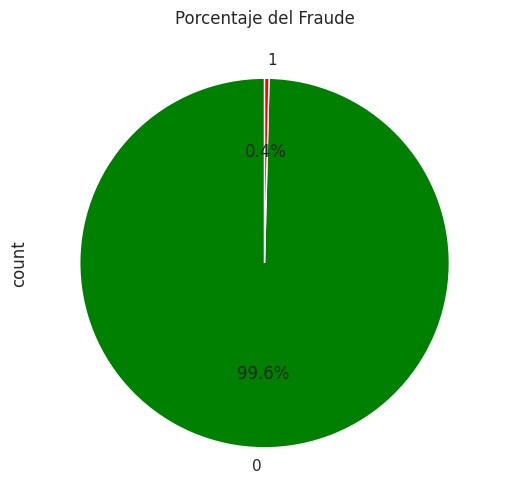

In [ ]:
plt.figure(figsize=(6, 6))
credit_card_fraud['es_fraude'].value_counts().plot.pie(autopct = '%.1f%%',colors = ['green', 'red'], startangle=90)
plt.title('Porcentaje del Fraude')


El gráfico pastel nos proporciona una visualización rápida de la proporción de fraudes en el conjunto de datos confirmando que las transacciones fraudulentas (en rojo) representan una pequeña fracción del total.

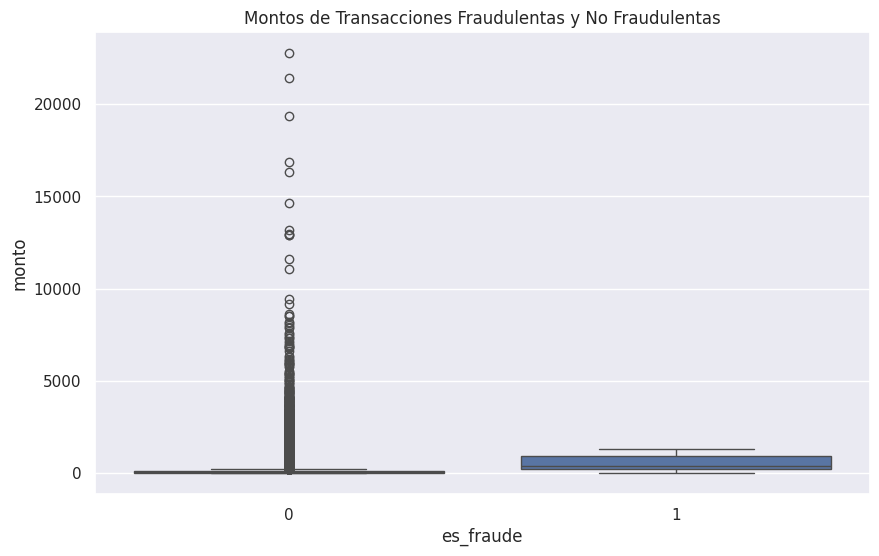

In [ ]:
# Comparación de montos en transacciones fraudulentas y no fraudulentas
plt.figure(figsize=(10, 6))
sns.boxplot(x='es_fraude', y='monto', data=credit_card_fraud)
plt.title('Montos de Transacciones Fraudulentas y No Fraudulentas')
plt.show()

Este gráfico de caja muestra la distribución de los montos de transacciones de tarjetas de crédito, comparando las transacciones fraudulentas (es_fraude = 1) con las no fraudulentas (es_fraude = 0). Los fraudes en tarjetas de crédito tienden a implicar montos más altos en comparación con las transacciones legítimas, lo que puede ser una indicación útil para la detección de fraudes. Además, la dispersión de los montos en las transacciones fraudulentas es mayor, indicando una mayor variabilidad en el valor de estas transacciones.

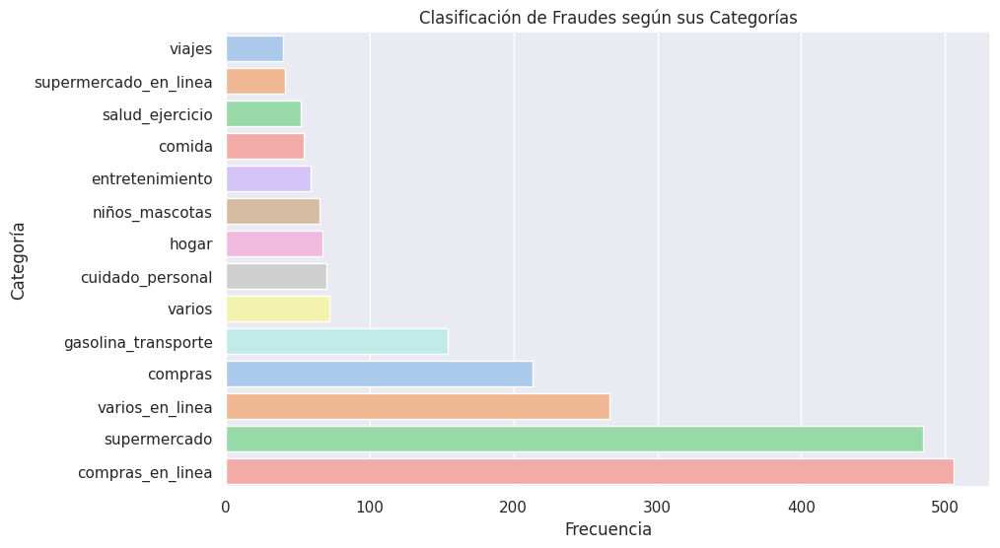

In [ ]:
# Calculamos la frecuencia de cada categoría
category_counts = transacciones_fraudulentas['categoria'].value_counts()

# Ordenar las categorías por frecuencia
category_counts = category_counts.sort_values(ascending=True)

# Crear un gráfico de barras horizontales
plt.figure(figsize=(10, 6))  # Establecer el tamaño de la figura
sns.barplot(x=category_counts.values, y=category_counts.index, palette='pastel', hue=category_counts.index, dodge=False, legend=False)

# Establecer etiquetas y título
plt.xlabel('Frecuencia')
plt.ylabel('Categoría')
plt.title('Clasificación de Fraudes según sus Categorías')

# Mostrar el gráfico
plt.show()

Las categorías se ordenan de manera ascendente por frecuencia, mostrando la diversidad de categorías en las transacciones. Este grafico muestra el contexto de cada transacción facilitando el análisis detallado de patrones de fraude enfocado en las categorías mas frecuentes.

**`PORCENTAJE POR GÉNERO`**

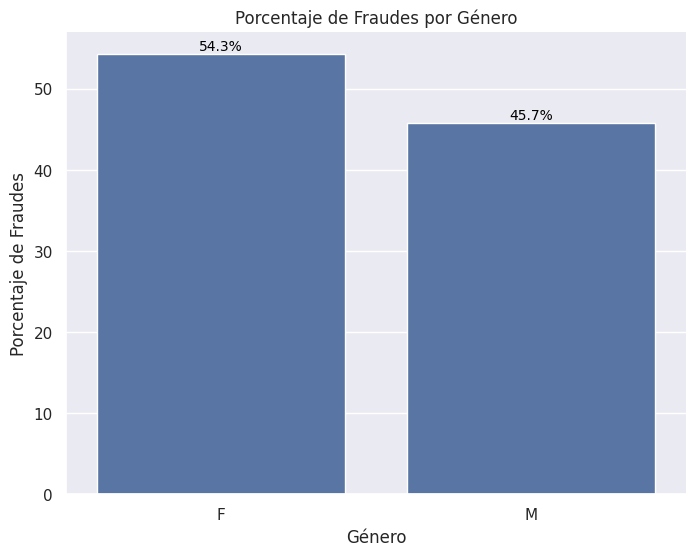

In [ ]:
fraud_percentage = transacciones_fraudulentas['genero'].value_counts(normalize=True) * 100

#tabla nueva
percentage_df = fraud_percentage.reset_index()
percentage_df.columns = ['genero', 'percentage']
# Crear un gráfico de barras
plt.figure(figsize=(8, 6))
sns.barplot(x='genero', y='percentage', data=percentage_df)
sns.despine()
# Etiquetas y título
plt.xlabel('Género')
plt.ylabel('Porcentaje de Fraudes')
plt.title('Porcentaje de Fraudes por Género')

# Añadir porcentajes encima de las barras
for index, row in percentage_df.iterrows():
    plt.text(index, row['percentage'] + 0.5, f'{row["percentage"]:.1f}%', ha='center', color='black', fontsize=10)

# Mostrar el gráfico
plt.show()

Visualizamos por género las transacciones fraudulentas.

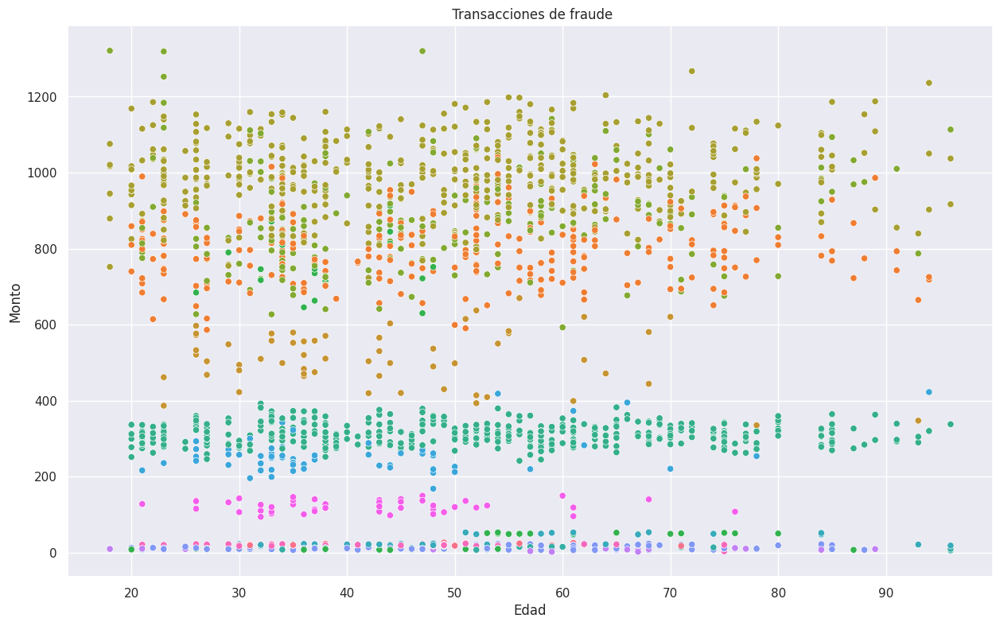

In [ ]:
# Crear el gráfico de dispersión
plt.figure(figsize=(15, 9))
sns.scatterplot(x='edad_cliente', y='monto', data=transacciones_fraudulentas,hue="categoria")
# Agregar etiquetas y título
plt.xlabel("Edad")
plt.ylabel("Monto")
plt.title(" Transacciones de fraude")
plt.legend([],[], frameon=False)
# Mostrar el gráfico
plt.show()

Como no se ve una distincion en el grafico segun categoria se realizo otro grafico para ver cada categoria

<Figure size 300x200 with 0 Axes>

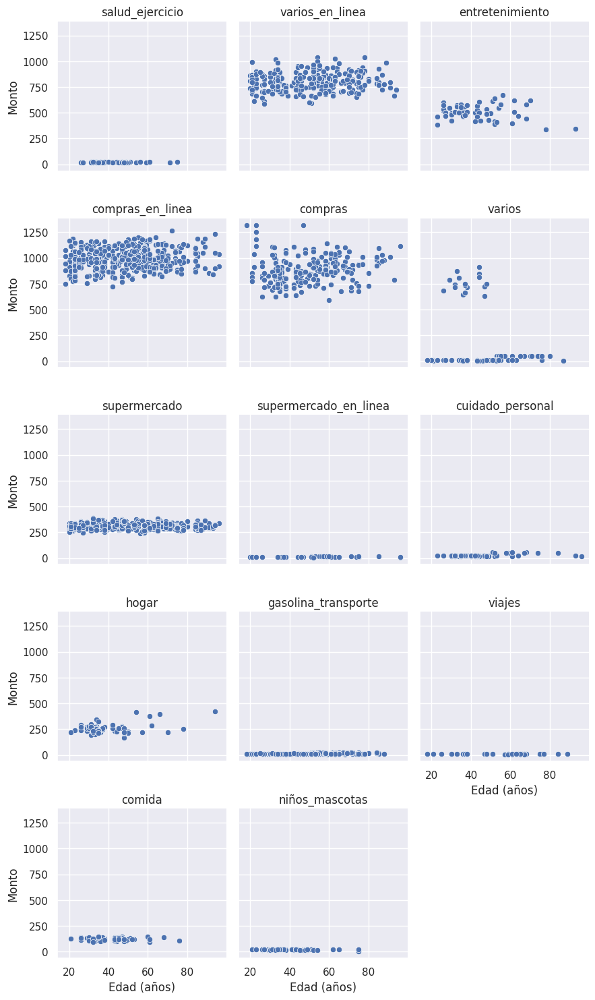

In [ ]:
# Crear el gráfico de dispersión
plt.figure(figsize=(3, 2))
g = sns.FacetGrid(data=transacciones_fraudulentas, col="categoria", col_wrap=3)
g.map_dataframe(sns.scatterplot, x='edad_cliente', y='monto')  # Use 'Edad' instead of 'edad'

# Agregar etiquetas y título
g.set_axis_labels('Edad (años)', 'Monto')
g.set_titles('{col_name}')

# Mostrar el gráfico
plt.show()

**DISTRIBUCIÓN DE LAS TRANSACCIONES DE FRAUDE**

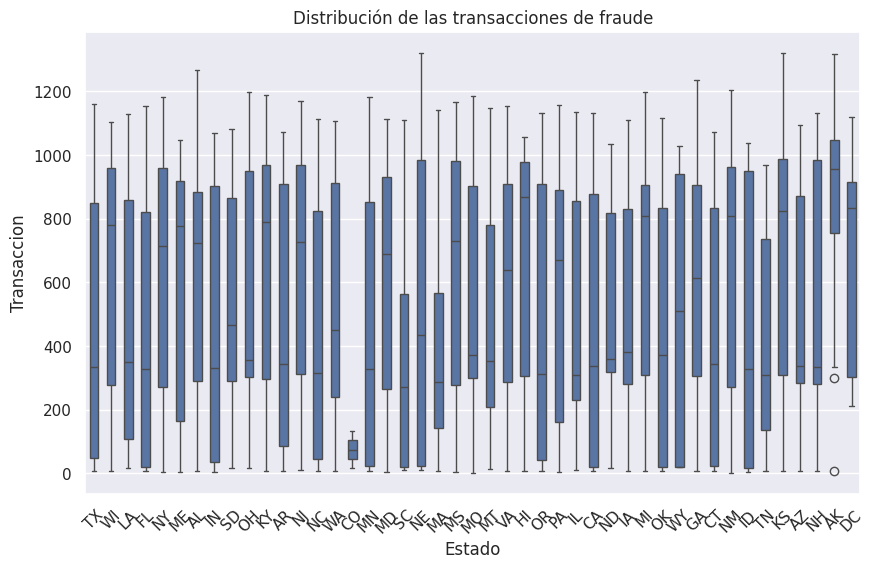

In [ ]:
plt.figure(figsize=(10, 6))  # Ajustar el tamaño de la figura

sns.boxplot(x='estado',y='monto', data=transacciones_fraudulentas,width=0.5)
plt.xticks(rotation=45)
plt.xlabel("Estado")
plt.ylabel("Transaccion")
plt.title("Distribución de las transacciones de fraude")
plt.show()

**GRÁFICO : HORA POR FRAUDE**

<Figure size 1200x800 with 0 Axes>

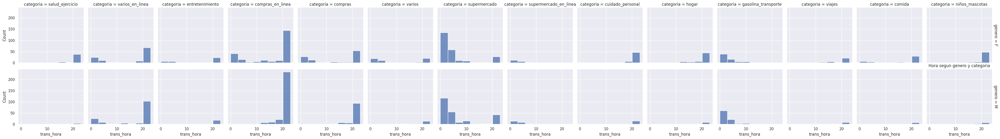

In [ ]:
plt.figure(figsize=(12, 8))
sns.set_theme(style="darkgrid")
sns.displot(
    transacciones_fraudulentas, x="trans_hora", col="categoria", row="genero",
    binwidth=3, height=3, facet_kws=dict(margin_titles=True),
)
plt.ylabel("Cantidad")
plt.title("Hora segun genero y categoria")
plt.show()

**SCATTER PLOT**

In [ ]:
plt.figure(figsize=(12, 8))  # Ajustar el tamaño de la fig

credit_card_fraud['fecha_transaccion'] = pd.to_datetime(credit_card_fraud['fecha_transaccion'],dayfirst=True)

sns.scatterplot(x='fecha_transaccion', y='monto', data=credit_card_fraud, color='#6b5b95', alpha=0.6)  # Ajustar el color y la transparencia
plt.xlabel('Fecha de la transacción')
plt.ylabel('Monto de la transacción')
plt.title('Gráfico de Dispersión: Monto de Transacción vs. Fecha')
plt.grid(True)  # Agregar una cuadrícula de fondo
plt.tight_layout()  # Ajustar el diseño para evitar solapamientos
plt.xticks(rotation=45)  # Rotar las etiquetas del eje x
plt.show()

Los puntos del gráfico muestran cómo varían los montos de las transacciones a lo largo del tiempo. Aquí vemos una visión clara de cómo los montos de las transacciones varían con el tiempo, lo que puede ser útil para identificar tendencias, picos de actividad y posibles anomalías en los datos de transacciones de tarjetas de crédito.

**FRECUENCIA DE LAS TRANSACCIONES**

In [ ]:
plt.figure(figsize=(14, 5))  # Ajustar el tamaño global de la figura

plt.subplot(1, 3, 1)  # 1 fila, 3 columnas, primer subgráfico
sns.histplot(fraud["monto"], color="#a8685e", kde=True)
plt.xlabel('Monto de la transaccion')
plt.ylabel('Frecuencia')
plt.title('Frencuancia de las transacciones')
sns.despine()

El histograma muestra la frecuencia de transacciones fraudulentas en diferentes rangos de montos.

La mayoría de las transacciones fraudulentas se agrupan en los rangos más bajos de montos, mientras que las transacciones de montos elevados son menos frecuentes.

La curva de densidad proporciona una visualización suave de la distribución de los montos, destacando picos y caídas en la frecuencia de las transacciones fraudulentas.

**GRÁFICO DE CORRELACIÓN**

In [ ]:
# Seleccionar solo las columnas numéricas
numeric_columns = credit_card_fraud.select_dtypes(include=['number']).columns

# Calcular la matriz de correlación
correlation_matrix = credit_card_fraud[numeric_columns].corr()

# Visualizar la matriz de correlación
plt.figure(figsize=(14, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5, linecolor='black')
plt.title('Matriz de Correlación', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()
plt.show()


In [ ]:
# !pip install plotly requests

import plotly.express as px
import requests

# URL de un archivo GeoJSON de EE.UU.
geojson_url = 'https://raw.githubusercontent.com/PublicaMundi/MappingAPI/master/data/geojson/us-states.json'

# Descargar el archivo GeoJSON
response = requests.get(geojson_url)
geojson = response.json()


# Crear un gráfico de dispersión geográfico utilizando Plotly
fig = px.scatter_geo(
    credit_card_fraud,
    lat='latitud',  # latitud del titular de la tarjeta
    lon='longitud',  # longitud del titular de la tarjeta
    color='es_fraude',  # variable que indica si es fraude o no
    hover_data=['latitud_comerciante', 'longitud_comerciante'],  # Ajusta según sea necesario.
    title='Ubicación de Fraudes por Latitud y Longitud de Titular en Estados Unidos'
)

# Eliminar la leyenda de colores
fig.update_layout(coloraxis_showscale=False)

# Configuración del mapa para centrarse en Estados Unidos
fig.update_geos(
    scope="usa",
    showcountries=True,
    countrycolor="RebeccaPurple"
)

fig.show()

Este gráfico de dispersión geográfico muestra la ubicación de las transacciones de tarjetas de crédito en los Estados Unidos, destacando las transacciones fraudulentas en comparación con las no fraudulentas. Cada punto en el mapa representa una transacción, con las coordenadas de latitud y longitud del titular de la tarjeta.

**Eliminar columnas**

In [ ]:
credit_card_fraud.drop(columns=['num_transaccion','num_tarjeta','comerciante','nombre','apellido','calle','codigo_postal','tiempo_unix'],axis=1,inplace=True)

**Guardar Los cambios del Dataset**

In [ ]:
arch='/content/drive/My Drive/Curso Ingenias/fraud_credit.csv'
credit_card_fraud.to_csv(arch, sep=',', index=False, encoding='utf-8')

# **CONCLUSIÓN**

Se a explorado un conjunto de datos detallado que contiene transacciones de tarjetas de crédito, diferenciadas entre legítimas y fraudulentas. Nuestro análisis se centró en identificar patrones y características distintivas que pueden ayudar en la detección eficiente de fraudes. Observamos que los fraudes, aunque representan una pequeña fracción del total de transacciones, tienden a involucrar montos más altos y muestran variabilidad en términos de categorías y horarios.

Este proyecto no solo busca la identificación de transacciones fraudulentas, sino también proporcionar herramientas y conocimientos que pueden aplicarse en contextos similares de detección de fraudes. Utilizamos herramientas como gráficos de dispersión, histogramas y análisis de correlación para profundizar en los datos y obtener insights valiosos.

En resumen, este estudio proporciona una visión integral sobre cómo los patrones en las transacciones fraudulentas pueden ser identificados y utilizados para mejorar las estrategias de detección y prevención de fraudes en el ámbito financiero.